# STS: Semantic Textual Similarity
Group #1 (STS) members:
- *Simona Malegori, 10689386*
- *Alberto Pirillo, 10667220*
- *Eleonora Sala, 10680847*
- *Federico Tognoni, 10676136*

# 1. Preliminary Analysis

## 1.1 Loading Dataset

In [14]:
import csv
import re
import plotly.express as px
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
sns.set_theme()
sns.set(font_scale=2)

In [15]:
path_train = 'data/sts-train.csv'
path_dev = 'data/sts-dev.csv'
path_test = 'data/sts-test.csv'

In [16]:
columns=['genre', 'file', 'year', 'index', 'score', 'sentence1', 'sentence2']

In [17]:
df_train = pd.read_csv(path_train, sep='\t', usecols=range(7), header=None, quoting=csv.QUOTE_NONE, names=columns, encoding='UTF-8')
df_dev = pd.read_csv(path_dev, sep='\t', usecols=range(7), header=None, quoting=csv.QUOTE_NONE, names=columns, encoding='UTF-8')
df_test = pd.read_csv(path_test, sep='\t', usecols=range(7), header=None, quoting=csv.QUOTE_NONE, names=columns, encoding='UTF-8')

In [18]:
df = pd.concat([df_train, df_dev, df_test]).reset_index(drop=True)
df

,genre,file,year,index,score,sentence1,sentence2
0,main-captions,MSRvid,2012test,1,5.00,A plane is taking off.,An air plane is taking off.
1,main-captions,MSRvid,2012test,4,3.80,A man is playing a large flute.,A man is playing a flute.
2,main-captions,MSRvid,2012test,5,3.80,A man is spreading shreded cheese on a pizza.,A man is spreading shredded cheese on an uncoo...
3,main-captions,MSRvid,2012test,6,2.60,Three men are playing chess.,Two men are playing chess.
4,main-captions,MSRvid,2012test,9,4.25,A man is playing the cello.,A man seated is playing the cello.
...,...,...,...,...,...,...,...
8623,main-news,headlines,2016,1354,0.00,"Philippines, Canada pledge to further boost re...",Philippines saves 100 after ferry sinks
8624,main-news,headlines,2016,1360,1.00,Israel bars Palestinians from Jerusalem's Old ...,"Two-state solution between Palestinians, Israe..."
8625,main-news,headlines,2016,1368,1.00,How much do you know about Secret Service?,Lawmakers from both sides express outrage at S...
8626,main-news,headlines,2016,1420,0.00,Obama Struggles to Soothe Saudi Fears As Iran ...,Myanmar Struggles to Finalize Voter Lists for ...


## 1.2 Dataset description
Composed of 3 sets of data:
- train
- dev
- test

The dataset contains sentences coming from 3 type of sources:
- captions
- news
- forums

Each row of the dataset contains (only relevant columns are mentioned here):
- genre: the type of the source
- year
- a pair of sentences to be compared on similarity
- score: a human made index of the similarity of the two sentences

In [19]:
print(f'Number of rows (2 sentences per row): {len(df)}')
print(f'Total number of sentences: {len(df)*2}')

Number of rows (2 sentences per row): 8628
Total number of sentences: 17256


## 1.3 Data cleaning

Check for the presence of null values:

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8628 entries, 0 to 8627
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   genre      8628 non-null   object 
 1   file       8628 non-null   object 
 2   year       8628 non-null   object 
 3   index      8628 non-null   int64  
 4   score      8628 non-null   float64
 5   sentence1  8628 non-null   object 
 6   sentence2  8628 non-null   object 
dtypes: float64(1), int64(1), object(5)
memory usage: 472.0+ KB


There are no null values.

In [21]:
df['genre'].value_counts()

genre
main-news        4299
main-captions    3250
main-forums       629
main-forum        450
Name: count, dtype: int64

In [22]:
df['genre'] = df['genre'].replace('main-', '', regex=True)
df['genre'] = df['genre'].replace('forum', 'forums')

In [23]:
df['genre'].value_counts()

genre
news        4299
captions    3250
forums      1079
Name: count, dtype: int64

In [24]:
# Remove everything in this column which is not a number
df['year'] = df['year'].replace(r'\D', '', regex=True)

MinMax scaling through scikit-learn:

In [25]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df['score'] = scaler.fit_transform(df[['score']])

In [26]:
df['score'].describe()

count    8628.000000
mean        0.525504
std         0.297152
min         0.000000
25%         0.280000
50%         0.560000
75%         0.760000
max         1.000000
Name: score, dtype: float64

In [27]:
df

,genre,file,year,index,score,sentence1,sentence2
0,captions,MSRvid,2012,1,1.00,A plane is taking off.,An air plane is taking off.
1,captions,MSRvid,2012,4,0.76,A man is playing a large flute.,A man is playing a flute.
2,captions,MSRvid,2012,5,0.76,A man is spreading shreded cheese on a pizza.,A man is spreading shredded cheese on an uncoo...
3,captions,MSRvid,2012,6,0.52,Three men are playing chess.,Two men are playing chess.
4,captions,MSRvid,2012,9,0.85,A man is playing the cello.,A man seated is playing the cello.
...,...,...,...,...,...,...,...
8623,news,headlines,2016,1354,0.00,"Philippines, Canada pledge to further boost re...",Philippines saves 100 after ferry sinks
8624,news,headlines,2016,1360,0.20,Israel bars Palestinians from Jerusalem's Old ...,"Two-state solution between Palestinians, Israe..."
8625,news,headlines,2016,1368,0.20,How much do you know about Secret Service?,Lawmakers from both sides express outrage at S...
8626,news,headlines,2016,1420,0.00,Obama Struggles to Soothe Saudi Fears As Iran ...,Myanmar Struggles to Finalize Voter Lists for ...


Now we can define a function to perform the same pre-processing steps in the 3 separated datasets.

In [28]:
def pre_processing(df_to_process: pd.DataFrame) -> pd.DataFrame:
    df_to_process['genre'] = df_to_process['genre'].replace('main-', '', regex=True)
    df_to_process['genre'] = df_to_process['genre'].replace('forum', 'forums')
    df_to_process['year'] = df_to_process['year'].replace(r'\D', '', regex=True)
    df_to_process['score'] = MinMaxScaler().fit_transform(df_to_process[['score']])
    return df_to_process

In [29]:
df_train = pre_processing(df_train)
df_dev = pre_processing(df_dev)
df_test = pre_processing(df_test)

## 1.4 Data Visualization

In [17]:
df_plot = df.copy()
df_plot['genre'] = pd.Categorical(df['genre'], categories=['captions', 'news', 'forums'], ordered=True)
df_plot['file'] = pd.Categorical(df['file'], categories=['MSRvid', 'images', 'track5.en-en', 'MSRpar', 'deft-news', 'headlines', 'deft-forum', 'answers-forums', 'answer-answer' ], ordered=True)

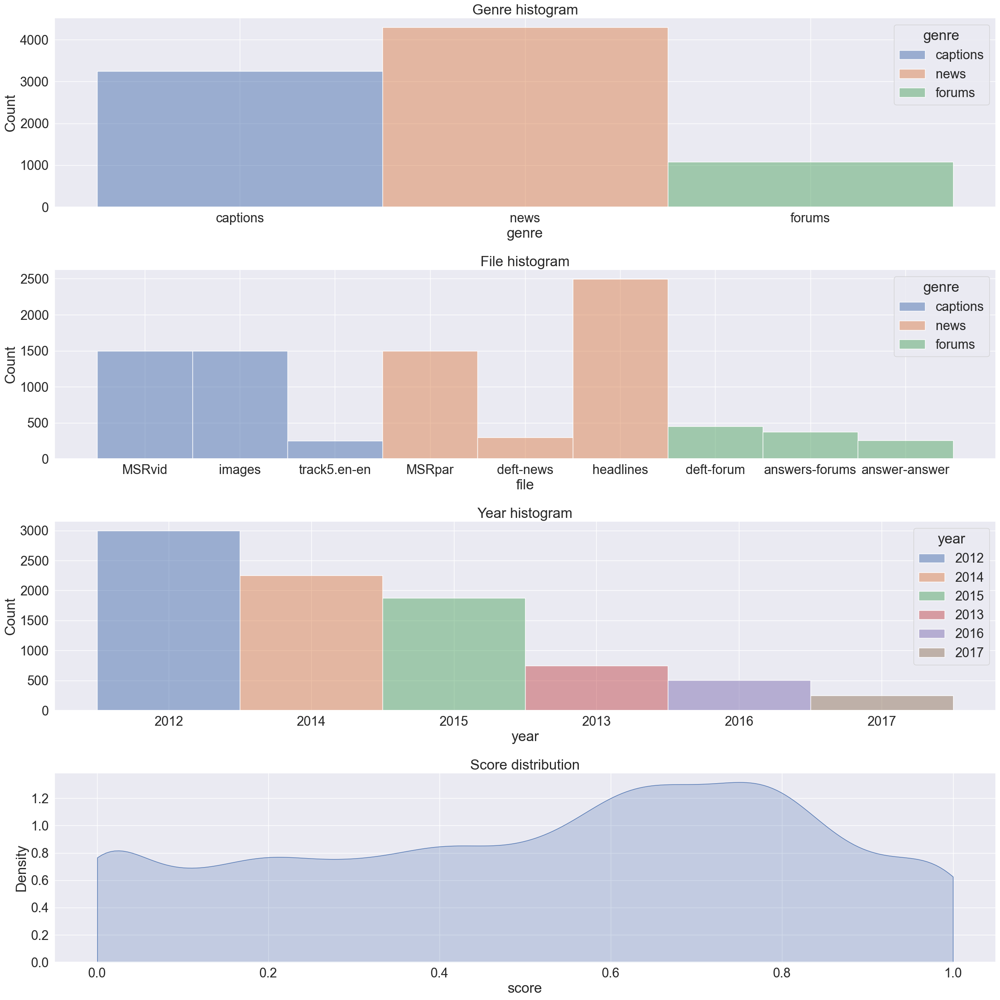

In [18]:
fig, axs = plt.subplots(4, 1, figsize=(24, 24))

axs[0].set_title('Genre histogram')
sns.histplot(data=df_plot, x='genre', hue='genre', ax=axs[0])
axs[1].set_title('File histogram')
sns.histplot(data=df_plot, x='file', hue='genre', ax=axs[1])
axs[2].set_title('Year histogram')
sns.histplot(data=df_plot, x='year', hue='year', ax=axs[2])
axs[3].set_title('Score distribution')
sns.kdeplot(data=df_plot, x='score', fill=True, clip=(0.0, 1.0), ax=axs[3])

fig.tight_layout()

## 1.5 Vocabulary Investigation

In [17]:
print(f'Total number of sentence pairs: {len(df)}')

Total number of sentence pairs: 8628


In [18]:
s1_len = df['sentence1'].apply(lambda x : len(str(x)))
s2_len = df['sentence2'].apply(lambda x : len(str(x)))

Average number of characters per sentence

In [19]:
avg_s1_len = s1_len.mean()
avg_s2_len = s2_len.mean()

print(f'Average number of characters of sentences 1: {avg_s1_len}')
print(f'Average number of characters of sentences 2: {avg_s2_len}')

Average number of characters of sentences 1: 58.23528048215113
Average number of characters of sentences 2: 57.9598980064905


**Processing sentences**:
- lowering the text,
- removing punctuation,
- getting the list of words for each sentence

In [20]:
import string

regex = '[' + string.punctuation + ']'

In [21]:
# new dataframe
df_processed = pd.DataFrame(columns=['sentence1', 'sentence2', 'vocab1', 'vocab2'])

# lowercase
df_processed['sentence1'] = df['sentence1'].apply(lambda x : x.lower())
df_processed['sentence2'] = df['sentence2'].apply(lambda x : x.lower())

# removing punctuation, split in words, sort words
df_processed['vocab1'] = df_processed['sentence1'].apply(lambda x: sorted(str(re.sub(regex, '', x)).split()))
df_processed['vocab2'] = df_processed['sentence2'].apply(lambda x: sorted(str(re.sub(regex, '', x)).split()))

Average number of words per sentence:

In [22]:
avg_vocab1_size = df_processed['vocab1'].apply(lambda x: len(x)).mean()
avg_vocab2_size = df_processed['vocab2'].apply(lambda x: len(x)).mean()

print(f'Average number of words per sentence 1: {avg_vocab1_size}')
print(f'Average number of words per sentence 2: {avg_vocab2_size}')

Average number of words per sentence 1: 10.163885025498377
Average number of words per sentence 2: 10.142095503013445


Merging the vocabulary of all sentences (one for sentences 1, one for sentences 2), computing:
- total number of words,
- vocabulary size, i.e. number of different words used

In [23]:
# vocabulary of sentences 1
global_vocab1 = df_processed['vocab1'].sum()
print(f'Total number of words (1): {len(global_vocab1)}')
print(f'Vocabulary size (1): {len(set(global_vocab1))}')

Total number of words (1): 87694
Vocabulary size (1): 12521


In [24]:
#vocabulary of sentences 2
global_vocab2 = df_processed['vocab2'].sum()
print(f'Total number of words (2): {len(global_vocab2)}')
print(f'Vocabulary size (2): {len(set(global_vocab2))}')

Total number of words (2): 87506
Vocabulary size (2): 12514


**Computing words occurrences**

In [25]:
import nltk
import matplotlib.pyplot as plt
import seaborn as sns

counts1 = nltk.Counter(global_vocab1)
counts2 = nltk.Counter(global_vocab2)

sns.set_theme()

In [26]:
# Considering words with frequency higher than 50
counts1_filtered = dict(filter(lambda x: x[1] > 50, counts1.items()))
counts2_filtered = dict(filter(lambda x: x[1] > 50, counts2.items()))

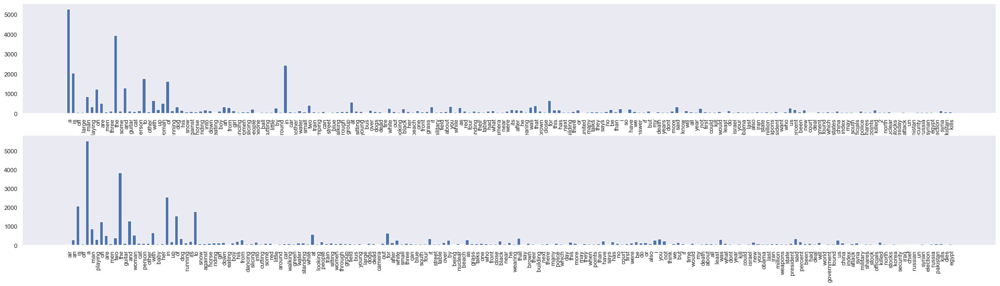

In [27]:
width = 0.7
_, axs = plt.subplots(2, 1, figsize=(32, 8))
axs[0].bar(np.arange(len(counts1_filtered)), counts1_filtered.values(), width)
axs[0].set_xticks(np.arange(len(counts1_filtered)) + width * 0.5, counts1_filtered.keys(), rotation=90)
axs[0].grid(False)

axs[1].bar(np.arange(len(counts2_filtered)), counts2_filtered.values(), width)
axs[1].set_xticks(np.arange(len(counts2_filtered)) + width * 0.5, counts2_filtered.keys(), rotation=90)
axs[1].grid(False)

Stopwords are highly frequent, although they're not very informative.

Words occurrences **removing stopwords**:

In [28]:
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Alby\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [29]:
# vocabulary 1 without stopwords
vocab1_nostop = [w for w in global_vocab1 if w not in stopwords.words('english')]
counts1_nostop = nltk.Counter(vocab1_nostop)

In [30]:
# vocabulary 2 without stopwords
vocab2_nostop = [w for w in global_vocab2 if w not in stopwords.words('english')]
counts2_nostop = nltk.Counter(vocab2_nostop)

In [31]:
# Considering words with frequency higher than 50
counts1_nostop_filtered = dict(filter(lambda x: x[1] > 50, counts1_nostop.items()))
counts2_nostop_filtered = dict(filter(lambda x: x[1] > 50, counts2_nostop.items()))

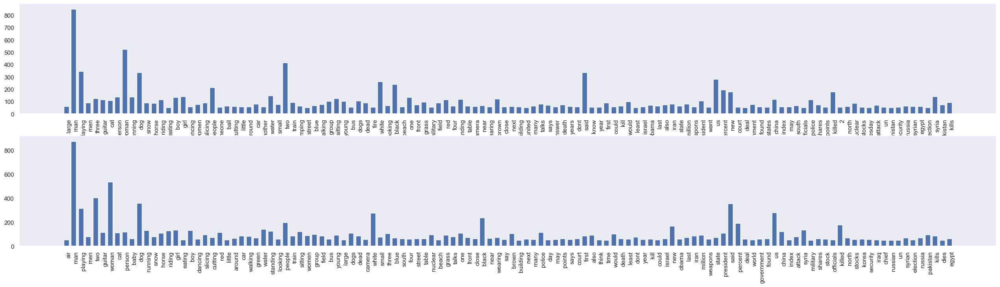

In [32]:
width = 0.7
_, axs = plt.subplots(2, 1, figsize=(32, 8))
axs[0].bar(np.arange(len(counts1_nostop_filtered)), counts1_nostop_filtered.values(), width)
axs[0].set_xticks(np.arange(len(counts1_nostop_filtered)) + width * 0.5, counts1_nostop_filtered.keys(), rotation=90)
axs[0].grid(False)

axs[1].bar(np.arange(len(counts2_nostop_filtered)), counts2_nostop_filtered.values(), width)
axs[1].set_xticks(np.arange(len(counts2_nostop_filtered)) + width * 0.5, counts2_nostop_filtered.keys(), rotation=90)
axs[1].grid(False)

Analysis of **vocabulary on the entire dataset** of sentences

In [33]:
global_vocab = global_vocab1 + global_vocab2
print(f'Total number of words: {len(global_vocab)}')
print(f'Vocabulary size: {len(set(global_vocab))}')

Total number of words: 175200
Vocabulary size: 15914


In [34]:
vocab_nostopwords = [w for w in global_vocab if w not in stopwords.words('english')]
counts_nostopwords = nltk.Counter(vocab_nostopwords)

In [35]:
# Considering words with frequency higher than 50
counts_nostopwords_filtered = dict(filter(lambda x: x[1] > 100, counts_nostopwords.items()))

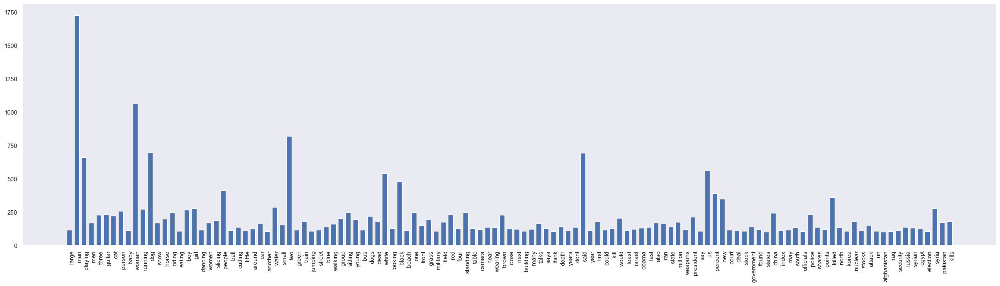

In [36]:
width = 0.7
_, axs = plt.subplots(1, 1, figsize=(32, 8))
axs.bar(np.arange(len(counts_nostopwords_filtered)), counts_nostopwords_filtered.values(), width)
axs.set_xticks(np.arange(len(counts_nostopwords_filtered)) + width * 0.5, counts_nostopwords_filtered.keys(), rotation=90)
axs.grid(False)

## 1.6 Word embeddings investigation

We will use pre-trained embeddings from the `gensim` library.

In [37]:
import gensim.downloader as api

model = api.load('word2vec-google-news-300')

In [38]:
print(f"Vocabulary size of the model: {len(model)}")
print(f"Number of dimensions of the embeddings: {model.vector_size}")

Vocabulary size of the model: 3000000
Number of dimensions of the embeddings: 300


Now we select the embeddings for the words in our dataset.

In [39]:
s1 = df['sentence1'].tolist()
s2 = df['sentence2'].tolist()
sentences = s1 + s2
sentences

['A plane is taking off.',
 'A man is playing a large flute.',
 'A man is spreading shreded cheese on a pizza.',
 'Three men are playing chess.',
 'A man is playing the cello.',
 'Some men are fighting.',
 'A man is smoking.',
 'The man is playing the piano.',
 'A man is playing on a guitar and singing.',
 'A person is throwing a cat on to the ceiling.',
 'The man hit the other man with a stick.',
 'A woman picks up and holds a baby kangaroo.',
 'A man is playing a flute.',
 'A person is folding a piece of paper.',
 'A man is running on the road.',
 'A dog is trying to get bacon off his back.',
 'The polar bear is sliding on the snow.',
 'A woman is writing.',
 "A cat is rubbing against baby's face.",
 'The man is riding a horse.',
 'A man pours oil into a pot.',
 'A man is playing a guitar.',
 'A panda is sliding down a slide.',
 'A woman is eating something.',
 'A woman peels a potato.',
 'The boy fell off his bike.',
 'The woman is playing the flute.',
 'A rabbit is running from an 

In [40]:
len(sentences), type(s1), type(s1[0])

(17256, list, str)

In [42]:
def sentence_to_embedding(sentence: str) -> np.ndarray:
    tokenized_sentences: list[str] = re.sub('\W', ' ', sentence).lower().split()
    tokenized_sentences = [sentence for sentence in tokenized_sentences if len(sentence) > 1]
    embedding = np.zeros(model.vector_size)
    for word in tokenized_sentences:
        if word in model:
            embedding += model[word]
    return embedding / len(sentence)

Build a single embedding for each sentence, by averaging the embeddings of the words in the sentence.

In [43]:
sentence_embeddings = np.array(list(map(sentence_to_embedding, sentences)))
sentence_embeddings.shape

(17256, 300)

Visualize sentence embeddings using t-SNE.

In [44]:
from sklearn.manifold import TSNE

# TODO: iterate more
tsne = TSNE(n_components=3, n_iter=500, n_jobs=-1, verbose=2)
tsne_embedding = tsne.fit_transform(sentence_embeddings)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 17256 samples in 0.008s...
[t-SNE] Computed neighbors for 17256 samples in 4.384s...
[t-SNE] Computed conditional probabilities for sample 1000 / 17256
[t-SNE] Computed conditional probabilities for sample 2000 / 17256
[t-SNE] Computed conditional probabilities for sample 3000 / 17256
[t-SNE] Computed conditional probabilities for sample 4000 / 17256
[t-SNE] Computed conditional probabilities for sample 5000 / 17256
[t-SNE] Computed conditional probabilities for sample 6000 / 17256
[t-SNE] Computed conditional probabilities for sample 7000 / 17256
[t-SNE] Computed conditional probabilities for sample 8000 / 17256
[t-SNE] Computed conditional probabilities for sample 9000 / 17256
[t-SNE] Computed conditional probabilities for sample 10000 / 17256
[t-SNE] Computed conditional probabilities for sample 11000 / 17256
[t-SNE] Computed conditional probabilities for sample 12000 / 17256
[t-SNE] Computed conditional probabilities for sam

In [45]:
x, y, z = np.transpose(tsne_embedding)
x1, y1, z1 = np.transpose(tsne_embedding[:len(df)])
x2, y2, z2 = np.transpose(tsne_embedding[len(df):])

Visualize the embeddings of a limited number of sentences, selected randomly.

In [46]:
n_rows = 50
ids = np.random.randint(0, len(df), n_rows)

In [47]:
fig1 = px.scatter_3d(x=x1[ids], y=y1[ids], z=z1[ids])
fig2 = px.scatter_3d(x=x2[ids], y=y2[ids], z=z2[ids])
fig1.update_traces(marker={'size': 7, 'color': 'red', 'line': {'width': 2}})
fig1.add_trace(fig2.data[0])

Select some similar and some non-similar sentences and visualize them.

In [48]:
similarity = [5, 4, 3, 2, 1, 0]
ids = [0, 29, 23, 71, 45, 141]
fig1 = px.scatter_3d(x=x1[ids], y=y1[ids], z=z1[ids], text=similarity)
fig2 = px.scatter_3d(x=x2[ids], y=y2[ids], z=z2[ids], text=similarity)
fig1.update_traces(marker={'size': 7, 'color': 'red', 'line': {'width': 2}})
fig1.add_trace(fig2.data[0])

## 1.7 Document clustering

In [49]:
from sklearn.cluster import KMeans

### 1.7.1 Cluster by genre

In [50]:
k = 3
kmeans = KMeans(n_clusters=k, max_iter=500, n_init=5)
kmeans.fit(sentence_embeddings)

KMeans(max_iter=500, n_clusters=3, n_init=5)

In [51]:
fig = px.scatter_3d(x=x, y=y, z=z, color=kmeans.labels_)
fig.update_traces(marker={'size': 7,'line': {'width': 2}})

In [52]:
genres = df['genre'].tolist() + df['genre'].tolist()
fig = px.scatter_3d(x=x, y=y, z=z, color=genres)
fig.update_traces(marker={'size': 7,'line': {'width': 2}})

Strong correlation.

### 1.7.2 Cluster by file

Which is equivalent to clustering by genre and file

In [53]:
df['file'].nunique()

9

In [54]:
k = 9
kmeans = KMeans(n_clusters=k, max_iter=500, n_init=5)
kmeans.fit(sentence_embeddings)

KMeans(max_iter=500, n_clusters=9, n_init=5)

In [55]:
fig = px.scatter_3d(x=x, y=y, z=z, color=kmeans.labels_)
fig.update_traces(marker={'size': 7,'line': {'width': 2}})

In [56]:
files = df['file'].tolist() + df['file'].tolist()
fig = px.scatter_3d(x=x, y=y, z=z, color=files)
fig.update_traces(marker={'size': 7,'line': {'width': 2}})

Small correlation.

### 1.7.3 Cluster by year

In [57]:
k = 6
kmeans = KMeans(n_clusters=k, max_iter=500, n_init=5)
kmeans.fit(sentence_embeddings)

KMeans(max_iter=500, n_clusters=6, n_init=5)

In [58]:
fig = px.scatter_3d(x=x, y=y, z=z, color=kmeans.labels_)
fig.update_traces(marker={'size': 7,'line': {'width': 2}})

In [59]:
years = df['year'].tolist() + df['year'].tolist()
fig = px.scatter_3d(x=x, y=y, z=z, color=years)
fig.update_traces(marker={'size': 7,'line': {'width': 2}})

## 1.8 Topic Modelling

Clustering by topic with LDA (Latent Dirichlet Allocation) by:
- fitting the model to find the composition of topics
- see how this model applies to the test set

In [60]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.preprocessing import LabelEncoder
from matplotlib import pyplot as plt

In [61]:
tp_sentences = pd.concat([df['sentence1'], df['sentence2']]).reset_index(drop=True)
tp_labels = pd.concat([df['genre'], df['genre']]).reset_index(drop=True)

tp_sentences_train, tp_sentences_test, tp_label_train, tp_label_test = train_test_split(tp_sentences, tp_labels, test_size=0.4)
print('No. training docs:', len(tp_sentences_train))
print('No. testing docs:', len(tp_sentences_test))

No. training docs: 10353
No. testing docs: 6903


Building CountVectorizer:

In [62]:
tp_vectorizer = CountVectorizer(stop_words='english',min_df=5,max_df=.5)
tp_vector_sentences_train = tp_vectorizer.fit_transform(tp_sentences_train)

In [63]:
tp_vocab = tp_vectorizer.get_feature_names_out()
len(tp_vocab)

2637

Fitting LDA:
- we'll learn 30 topics, since the dataset is not that big
- with 50 iterations

In [64]:
lda = LatentDirichletAllocation(n_components=30, verbose=1, learning_method='online', max_iter=50, n_jobs=-1)
lda.fit(tp_vector_sentences_train)

iteration: 1 of max_iter: 50
iteration: 2 of max_iter: 50
iteration: 3 of max_iter: 50
iteration: 4 of max_iter: 50
iteration: 5 of max_iter: 50
iteration: 6 of max_iter: 50
iteration: 7 of max_iter: 50
iteration: 8 of max_iter: 50
iteration: 9 of max_iter: 50
iteration: 10 of max_iter: 50
iteration: 11 of max_iter: 50
iteration: 12 of max_iter: 50
iteration: 13 of max_iter: 50
iteration: 14 of max_iter: 50
iteration: 15 of max_iter: 50
iteration: 16 of max_iter: 50
iteration: 17 of max_iter: 50
iteration: 18 of max_iter: 50
iteration: 19 of max_iter: 50
iteration: 20 of max_iter: 50
iteration: 21 of max_iter: 50
iteration: 22 of max_iter: 50
iteration: 23 of max_iter: 50
iteration: 24 of max_iter: 50
iteration: 25 of max_iter: 50
iteration: 26 of max_iter: 50
iteration: 27 of max_iter: 50
iteration: 28 of max_iter: 50
iteration: 29 of max_iter: 50
iteration: 30 of max_iter: 50
iteration: 31 of max_iter: 50
iteration: 32 of max_iter: 50
iteration: 33 of max_iter: 50
iteration: 34 of ma

LatentDirichletAllocation(learning_method='online', max_iter=50,
                          n_components=30, n_jobs=-1, verbose=1)

Compute perplexity on unseen data:

In [65]:
tp_vector_sentences_test = tp_vectorizer.transform(tp_sentences_test)
lda.perplexity(tp_vector_sentences_test)

3343.5060014916994

Learned topics:

In [66]:
for i in range(len(lda.components_)):
    sorted_terms = lda.components_[i].argsort()[::-1]
    concatenated_terms = '[' + ', '.join(tp_vocab[i] for i in sorted_terms[:10]) + ']'
    print (f'Topic {i + 1}:\t', concatenated_terms)

Topic 1:	 [people, girl, eating, road, treaty, sheep, going, money, europe, young]
Topic 2:	 [couple, david, wood, january, players, football, sold, planned, hope, read]
Topic 3:	 [new, shares, stock, week, percent, chief, york, high, food, drug]
Topic 4:	 [water, iran, women, world, officials, city, told, head, storm, makes]
Topic 5:	 [russia, years, area, good, general, votes, accident, parliament, son, gets]
Topic 6:	 [percent, 10, points, index, deal, nasdaq, 30, problem, opposition, fell]
Topic 7:	 [men, quarter, service, hit, making, boys, fighting, scandal, saudi, gun]
Topic 8:	 [death, know, war, leader, crash, toll, japan, bangladesh, calls, 17]
Topic 9:	 [attack, kill, court, says, election, say, open, dies, 000, air]
Topic 10:	 [egypt, minister, france, collapse, iranian, french, meet, prime, morsi, cuts]
Topic 11:	 [president, train, group, state, year, runs, billion, old, play, law]
Topic 12:	 [wednesday, forces, child, thursday, bike, girls, depends, meeting, department, 

Plot of topic compositions:

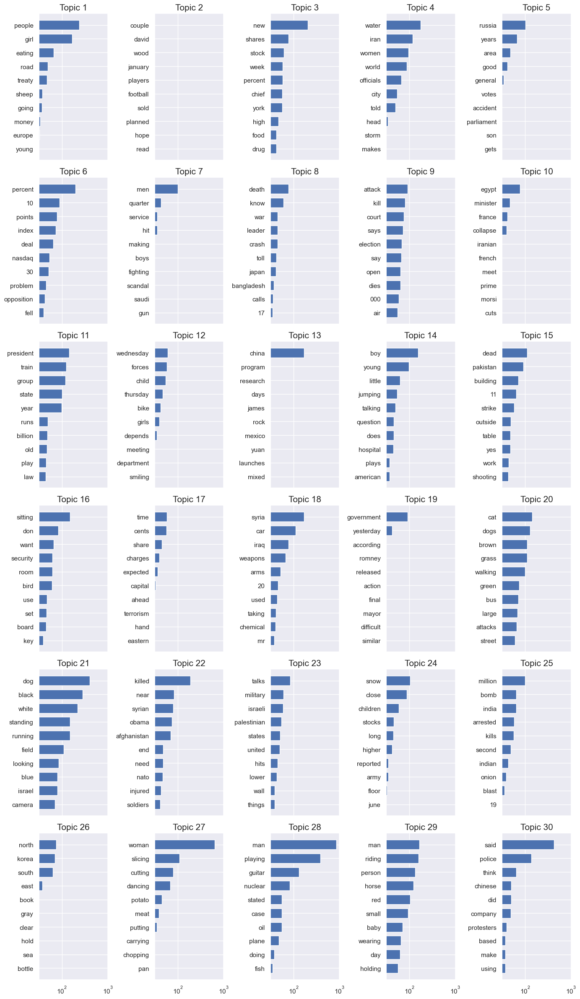

In [67]:
num_words = 10
cols = 5
rows = int(len(lda.components_)/5)

fig, axes = plt.subplots(rows, cols, figsize=(14, 4 * rows), sharex='all')
axes = axes.flatten()
for topic_idx, topic in enumerate(lda.components_):
    top_terms_index = topic.argsort()[:-num_words - 1:-1]
    top_terms = [tp_vocab[i] for i in top_terms_index]
    weights = topic[top_terms_index]
    ax = axes[topic_idx]
    ax.barh(top_terms, weights, height=0.7)
    ax.set_title(f'Topic {topic_idx +1}',fontdict={'fontsize': 15})
    ax.invert_yaxis()
    ax.set_xscale('log')

plt.subplots_adjust(top=0.90, bottom=0.05, wspace=0.90, hspace=0.3)
plt.tight_layout()
plt.show()

Using TSNE to reduce dimensionality:

In [68]:
from sklearn.manifold import TSNE

tsne_embedding = TSNE(n_components=3).fit_transform(lda.transform(tp_vector_sentences_test))
tsne_embedding.shape

(6903, 3)

In [69]:
[x, y, z] = np.transpose(tsne_embedding)

Plot colored on genre:

In [70]:
fig = px.scatter_3d(x=x, y=y, z=z, color=LabelEncoder().fit_transform(tp_label_test))
fig.update_traces(marker={'size': 3,'line': {'width': 2}})

Plot colored on the learned topics:

In [71]:
freq_topic = [topic_vec.argsort()[-1] for topic_vec in lda.transform(tp_vector_sentences_test)]

fig = px.scatter_3d(x=x, y=y, z=z, color=freq_topic)
fig.update_traces(marker={'size': 3,'line': {'width': 2}})

#  2. Models

We will evaluate the quality of our models using the following metrics:
- Mean Absolute Error (MAE)
- Root Mean Square Error (RMSE)
- R2 Score

Evaluations are performed on the test set.

We will use the following data structure to keep track of the values of the metrics for every possible model we are going to use, so that we can plot and compare them later.

In [74]:
metrics_results = {
    'mae': list(),
    'rmse': list(),
    'r2': list()
}

The following function computes the metrics, prints them and stores them into the data structure.

In [75]:
def evaluate(scores: np.ndarray, model_name: str , model_type: str) -> None:
    # Compute the metrics
    actual_scores = df_test['score'].to_numpy()
    mae = mean_absolute_error(actual_scores, scores)
    rmse = mean_squared_error(actual_scores, scores, squared=False)
    r2 = r2_score(actual_scores, scores)

    # Print the results
    print(f"MAE: {mae:.5f}")
    print(f"RMSE: {rmse:.5f}")
    print(f"R2: {r2:.5f}")

    # Store the results in a dictionary
    metrics_results['mae'].append((model_name, model_type, mae))
    metrics_results['rmse'].append((model_name, model_type, rmse))
    metrics_results['r2'].append((model_name, model_type, r2))

## 2.1 TF-IDF

### 2.1.1 Unsupervised

### 2.1.2 Supervised

### 2.1.3 POS Tagging

## 2.2 Word2Vec

### 2.2.1 Unsupervised

### 2.2.2 Supervised

## 2.3 Bi-encoder

The library `sentence_transformers` contains state-of-the-art models that can be trained using *supervised* or *unsupervised* approaches to encode text at sentence-level, paragraph-level or even entire document-level.

These models generate context embeddings that represent all the information in a sentence directly, without the need to compute word embeddings separately and averaging them together. This is the ideal approach for our task given that we are working at the sentence-level.

The library gives access to both bi-encoder and cross-encoder models.
First of all, we will use a multipurpose bi-encoder based on BERT:

In [19]:
from sentence_transformers import SentenceTransformer

In [20]:
bi_enc = SentenceTransformer('all-mpnet-base-v2', device='cuda')

### 2.3.1 Unsupervised

For the unsupervised part, we can use the pre-trained model directly.

We will compute the context embeddings of every pair of sentences in our test dataset.

In [21]:
s1_test = bi_enc.encode(df_test['sentence1'], show_progress_bar=True)
s2_test = bi_enc.encode(df_test['sentence2'], show_progress_bar=True)

Batches:   0%|          | 0/44 [00:00<?, ?it/s]

Batches:   0%|          | 0/44 [00:00<?, ?it/s]

Now we can compute the similarity as usual:

In [22]:
pred_scores = cosine_similarity(s1_test, s2_test).diagonal()
pred_scores

array([0.7515025 , 0.8024217 , 0.9708813 , ..., 0.5013466 , 0.13306266,
       0.3166734 ], dtype=float32)

In [23]:
evaluate(pred_scores, 'Bi-encoder', 'Unsupervised')

MAE: 0.13896
RMSE: 0.18049
R2: 0.64980


We can see that there was a good improvement in the performance. But we can do better.

### 2.3.2 Supervised

For the supervised part, we can fine-tune the model using our dataset.
We will perform the fine-tuning using both the training dataset and the validation dataset.
Then, we will evaluate the performance of the fine-tuned model on the testing dataset.

In [24]:
from sentence_transformers import losses, InputExample
from sentence_transformers.evaluation import EmbeddingSimilarityEvaluator
from sentence_transformers.cross_encoder.evaluation import CECorrelationEvaluator
from torch.utils.data import DataLoader
from math import ceil

First of all, we need to prepare our input data such that it is in the shape accepted by the library.

In [25]:
df_train_dev = pd.concat([df_train, df_dev]).reset_index(drop=True)

In [26]:
train_samples = df_train_dev.apply(lambda row: InputExample(texts=[row['sentence1'], row['sentence2']], label=row['score']), axis=1).to_list()
test_samples = df_test.apply(lambda row: InputExample(texts=[row['sentence1'], row['sentence2']], label=row['score']), axis=1).to_list()
len(train_samples), len(test_samples)

(7249, 1379)

In [27]:
# Training hyper-parameters
train_batch_size = 32
num_epochs = 5

In [28]:
train_dataloader = DataLoader(train_samples, shuffle=True, batch_size=train_batch_size)
loss = losses.CosineSimilarityLoss(model=bi_enc)
evaluator = EmbeddingSimilarityEvaluator.from_input_examples(test_samples)
warmup_steps = ceil(len(train_dataloader) * num_epochs * 0.1) # 10% of train data for warm-up

The following cell computes the fine-tuning.
Fine-tuning takes a while and also quite a good amount of GPU memory.
Note that at the end of the procedure, the fine-tuned model is stored into the device.

In [29]:
# Train the model

# TODO: remove comments
# bi_enc.fit(train_objectives=[(train_dataloader, loss)],
#           evaluator=evaluator,
#           epochs=num_epochs,
#           evaluation_steps=1000,
#           warmup_steps=warmup_steps,
#           output_path="all-mpnet-base-v2-fine-tuned")

We can now load the fine-tuned model to evaluate it.

In [30]:
bi_enc_tuned = SentenceTransformer("models/all-mpnet-base-v2-fine-tuned")

In [31]:
s1_test = bi_enc_tuned.encode(df_test['sentence1'])
s2_test = bi_enc_tuned.encode(df_test['sentence2'])

In [32]:
pred_scores = cosine_similarity(s1_test, s2_test).diagonal()
evaluate(pred_scores, 'Bi-encoder', 'Supervised')

MAE: 0.11547
RMSE: 0.15149
R2: 0.75328


We can see that fine-tuning lead to a significant increase in the performance.

## 2.4 Cross-encoder

Cross-encoders are another type of model available in the `sentence_transformers` library. They are known to be slower than bi-encoders and not to return any embeddings, meaning that we cannot store them in a database for later use. However, their performance is usually superior.

We will use a cross-encoder also based on BERT, designed specifically to deal with the sentence similarity task.

In [33]:
from sentence_transformers import CrossEncoder

In [34]:
cross_enc = CrossEncoder('cross-encoder/stsb-roberta-large', device='cuda')

### 2.4.1 Unsupervised

Again, the unsupervised part consists in encoding the pair of sentences using the pre-trained model.
This time, the model outputs the similarity score directly.

In [35]:
sentence_pairs = df_test[['sentence1', 'sentence2']].to_numpy().tolist()

In [36]:
pred_scores = cross_enc.predict(sentence_pairs, show_progress_bar=True)
evaluate(pred_scores, 'Cross-encoder', 'Unsupervised')

Batches:   0%|          | 0/44 [00:00<?, ?it/s]

MAE: 0.09132
RMSE: 0.12273
R2: 0.83807


As expected, cross-encoders are out-performing any other model.

### 2.4.2 Supervised

Again, we will fine-tune the model using the data at our disposal.

In [37]:
# Training hyper-parameters
train_batch_size = 24
num_epochs = 5

In [38]:
train_samples = df_train_dev.apply(lambda row: InputExample(texts=[row['sentence1'], row['sentence2']], label=row['score']), axis=1).to_list()
test_samples = df_test.apply(lambda row: InputExample(texts=[row['sentence1'], row['sentence2']], label=row['score']), axis=1).to_list()
len(train_samples), len(test_samples)

(7249, 1379)

In [39]:
train_dataloader = DataLoader(train_samples, shuffle=True, batch_size=train_batch_size)
cross_evaluator = CECorrelationEvaluator.from_input_examples(test_samples)

In [40]:
# # Train the model

# TODO: remove comments
# cross_enc.fit(train_dataloader=train_dataloader,
#           evaluator=cross_evaluator,
#           epochs=num_epochs,
#           warmup_steps=warmup_steps,
#           output_path="stsb-roberta-large-fine-tuned")

In [41]:
cross_enc_tuned = CrossEncoder("models/stsb-roberta-large-fine-tuned")

In [42]:
pred_scores = cross_enc_tuned.predict(sentence_pairs, show_progress_bar=True)
evaluate(pred_scores, 'Cross-encoder', 'Supervised')

Batches:   0%|          | 0/44 [00:00<?, ?it/s]

MAE: 0.09161
RMSE: 0.12272
R2: 0.83811


We can see that there is virtually no difference between the performance of the pre-trained model and of the fine-tuned model.

This is expected since this specific model was already trained using the STS dataset. The model has already seen that data, therefore it cannot learn anything new during the fine-tuning.

## 2.5 Comparison

In this section we compare the performance of all the models considered.

The following is a helper function to generate bar plots.

In [79]:
def plot_results(df: pd.DataFrame, title: str) -> None:
    _, ax = plt.subplots(figsize=(16, 8))
    sns.barplot(data=df, x='type', y='value', hue='model', palette='muted', width=0.6, ax=ax)
    ax.set_title(title)
    # ax.set_yticks(np.arange(0, 101, 10))
    ax.set_ylabel("Metric value")
    ax.set_xlabel("Model")
    ax.set_axisbelow(True)
    ax.grid(axis='x', visible=False)
    ax.grid(axis='y', color='gray')
    ax.legend()

We will generate a separate bar plot for each one of 3 metrics considered.

In each plot we can compare the effectiveness of all models both with an unsupervised and a supervised approach.

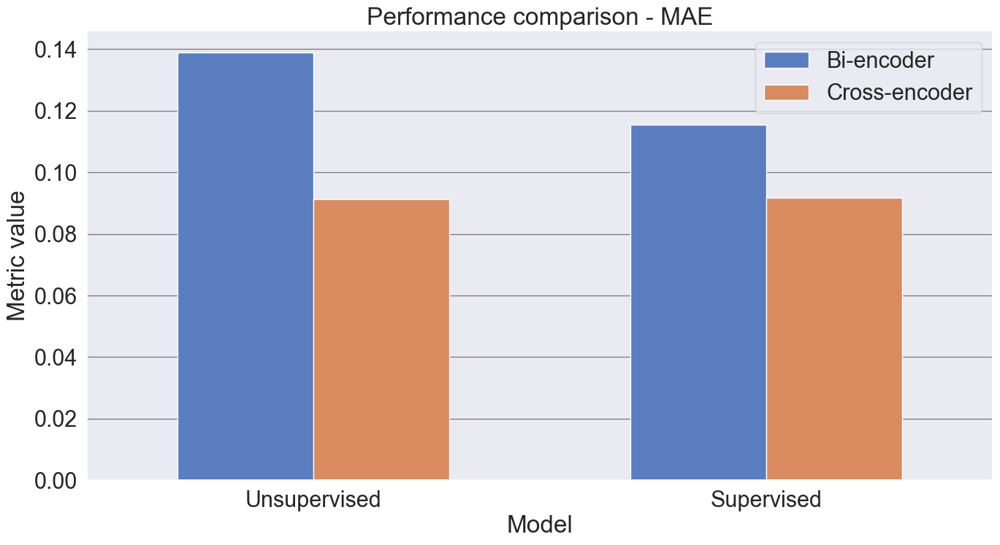

In [44]:
mae_df = pd.DataFrame(metrics_results['mae'], columns=['model', 'type', 'value'])
plot_results(mae_df, 'Performance comparison - MAE')

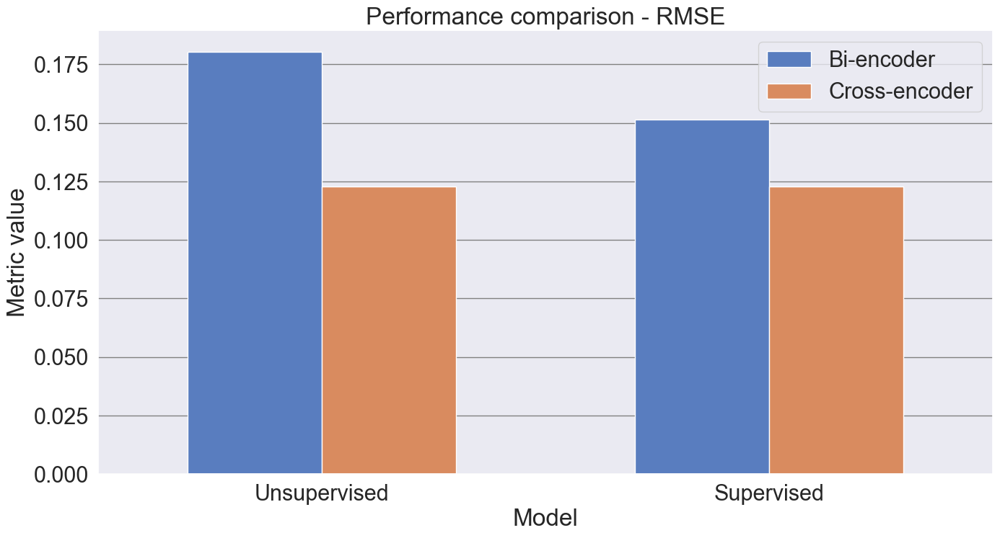

In [45]:
rmse_df = pd.DataFrame(metrics_results['rmse'], columns=['model', 'type', 'value'])
plot_results(rmse_df, 'Performance comparison - RMSE')

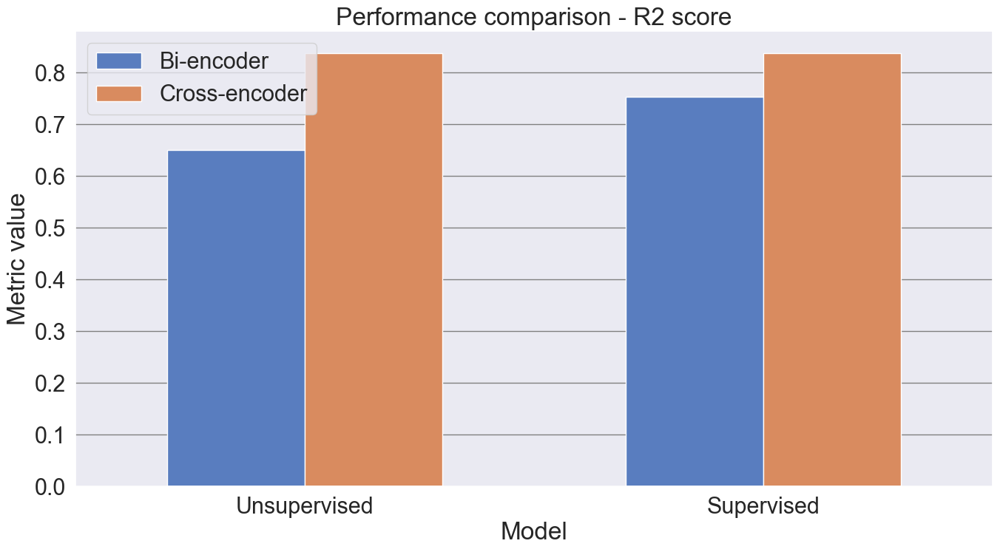

In [46]:
r2_df = pd.DataFrame(metrics_results['r2'], columns=['model', 'type', 'value'])
plot_results(r2_df, 'Performance comparison - R2 score')

# 3. Extensions

## 3.1 Asking ChatGPT

Very common nowadays...

In [30]:
from ast import literal_eval
from tqdm.notebook import trange
import openai
import tiktoken
import time

ChatGPT is based on GPT 3.5, a large language model trained by OpenAI.
Given that it is a large language model, GPT 3.5 should already have a deep understanding of text.
Meaning that it can already perform NLP tasks without any fine-tuning.

Note that to have GPT 3.5 respond to our queries, we have to provide a valid OpenAI API key.

In [31]:
openai.api_key  = ""

We need to provide a prompt to GPT 3.5, which is a sentence that will be used by the model to generate a response.

In [32]:
system_content = """
Your task is to compute the similarity of multiple pair of sentences.
The similarity is a real number that takes range from 0 to 5.
"""

We are instructing the model to compute the similarity between two sentences, following the same guidelines used to annotate the STS dataset, taken from the dataset's [paper](https://aclanthology.org/S17-2001.pdf).

In [33]:
score_guidelines = """
To determine the score, follow the guidelines delimited by triple backticks. Note that they are not labels, but guidelines. You can answer with any score as long as it is a real number and takes range from 0.0 to 5.0.
```
- Score 5.0: the two sentences are completely equivalent, as they mean the same thing.
- Score 4.0: the two sentences are mostly equivalent, but some unimportant details differ.
- Score 3.0: the two sentences are roughly equivalent, but some important information differs/missing.
- Score 2.0: the two sentences are not equivalent, but share some details.
- Score 1.0: the two sentences are not equivalent, but are on the same topic.
- Score 0.0: the the two sentences are completely dissimilar.
```
"""

In [34]:
input_format = """
You will receive the multiple pair of sentences in the following format, delimited by triple backticks:
```
[Pair 1]
- "First sentence of the first pair."
- "Second sentence of the first pair."

[Pair 2]
- "First sentence of the second pair."
- "Second sentence of the second pair."

[Pair 3]
- "First sentence of the third pair."
- "Second sentence of the third pair."
```
"""

In [35]:
few_shots_examples = """
The following are few-shot sample pairs of sentences and their similarity score:

Example 1:
- "A cat is playing a piano."
- "A man is playing a guitar."
Score: 0.6

Example 2:
- "Runners race around a track."
- "Runners compete in a race."
Score: 3.2

Example 3:
- "A person is slicing a tomato."
- "A person is slicing some meat."
Score: 1.75
"""

In [36]:
output_format = """
Your answer must contain a a list of scores that has one element for each pair received. The first element of the list must be the similarity score of the first pair of sentences, the second element must be the similarity score of the second pair of sentences, and so on and so forth.

An example of an answer is delimited in triple backticks below:
```[ 2.7, 3.2, 1.3 ]```

"""

The following is a helper function to concatenate multiple pair of sentences into a single string, so that we can pass multiple pair of sentences into a single request.

In [37]:
def concat_sentences(start: int, amount: int = 15) -> str:
    message = "The following are the sentences you need to compute the similarity score for:"
    for i, j in enumerate(range(start, start + amount)):
        message += f"""
[Pair {i + 1}]
- "{df_test['sentence1'][j]}"
- "{df_test['sentence2'][j]}"
"""
    return message

GPT-3.5 can handle at most 4096 tokens in a single request.
We need to use a tokenizer to make sure that the prompt does not exceed the limit.

In [38]:
tokenizer = tiktoken.encoding_for_model("gpt-3.5-turbo")

The following functions are used to send the prompt to the model and collect its answer.
Note that we are also checking the number of tokens and raising an exception if it is too large.

In [39]:
def get_completion(prompt, model="gpt-3.5-turbo"):
    messages = [{"role": "user", "content": prompt}]
    response = openai.ChatCompletion.create(
        model=model,
        messages=messages,
        temperature=0,
    )
    return response.choices[0].message["content"]

In [40]:
def perform_request(sentences: str) -> list[float]:
    # Concatenate all the strings inside message dictionary
    prompt = system_content + score_guidelines + input_format + few_shots_examples + output_format + sentences

    # Check the number of tokens in the message
    if  len(tokenizer.encode(prompt)) > 3900:
        raise Exception("The number of tokens in the message exceeds the limit.")

    # Perform the request and return the response
    response = get_completion(prompt)
    return literal_eval(response)

Testing has shown that (aside from the constraint on the number of tokens) we cannot pass too many pair of sentences to the model otherwise its performance will degrade significantly.

Therefore, we need to send multiple requests to the model and concatenate the results.
In particular, we will send 15 pair of sentences in each request.
Note that we need to check that, for every request, the model returns a consistent output. An exception is raised otherwise.

To allow for a fair comparison with the other models considered, we are asking GPT 3.5. to compute the similarity of the sentences of the test set only.

In [63]:
pred_scores = list()

In [68]:
start_sentence = 0
n_sentences = 1365
sentences_per_request = 15

for i in trange(start_sentence, n_sentences, sentences_per_request):
    # Perform the request and save the response
    message = concat_sentences(i, amount=sentences_per_request)
    response = perform_request(message)
    print(f"Similarity of sentences from {i + 1} to {i + sentences_per_request}: {response}")
    # Check that the response is consistent
    if len(response) != sentences_per_request:
        raise Exception("The number of scores returned is not equal to the number of sentences.")
    pred_scores = pred_scores + response
    # Wait for 5 seconds to avoid exceeding the rate limit
    time.sleep(5)

  0%|          | 0/8 [00:00<?, ?it/s]

Similarity of sentences from 1246 to 1260: [4.5, 4.2, 1.2, 0.8, 4.5, 4.5, 4.0, 4.5, 1.5, 0.5, 4.8, 2.5, 4.8, 3.5, 4.5]
Similarity of sentences from 1261 to 1275: [3.5, 2.8, 4.5, 1.2, 3.7, 3.5, 4.5, 4.0, 1.0, 1.5, 3.0, 4.0, 2.0, 3.8, 4.2]
Similarity of sentences from 1276 to 1290: [2.5, 1.8, 4.5, 1.2, 4.5, 1.0, 1.5, 2.5, 4.0, 1.5, 4.5, 4.5, 1.5, 1.0, 2.5]
Similarity of sentences from 1291 to 1305: [4.5, 1.5, 4.0, 4.5, 3.2, 1.0, 4.0, 1.5, 1.75, 4.5, 2.5, 2.5, 2.0, 2.5, 2.5]
Similarity of sentences from 1306 to 1320: [1.5, 3.8, 2.5, 3.7, 3.2, 4.0, 4.8, 2.0, 4.2, 2.8, 4.5, 4.5, 4.5, 2.0, 0.5]
Similarity of sentences from 1321 to 1335: [4.5, 2.8, 4.5, 3.5, 4.9, 4.0, 4.8, 3.2, 1.5, 4.8, 2.5, 1.0, 2.5, 2.5, 3.5]
Similarity of sentences from 1336 to 1350: [4.5, 4.2, 4.5, 1.2, 3.8, 4.5, 4.8, 2.5, 1.5, 1.0, 2.5, 4.8, 4.5, 4.8, 2.5]
Similarity of sentences from 1351 to 1365: [5.0, 4.5, 4.5, 4.0, 3.5, 3.5, 2.0, 4.5, 2.5, 2.0, 1.0, 2.5, 2.0, 4.5, 4.0]


We need to send the last request separately since the number of sentences in the test set is not a multiple of 15.

In [69]:
amount = len(df_test) - n_sentences
message = concat_sentences(n_sentences, amount=amount)
response = perform_request(message)
print(f"Similarity of sentences from {n_sentences + 1} to {n_sentences + amount}: {response}")
if len(response) != amount:
    raise Exception("The number of scores returned is not equal to the number of sentences.")
pred_scores = pred_scores + response

Similarity of sentences from 1366 to 1379: [2.5, 2.8, 3.5, 1.8, 2.2, 1.0, 2.7, 2.2, 2.0, 2.8, 1.2, 2.5, 2.1, 3.2]


We need to rescale the scores returned by GPT 3.5 to make them comparable with the current values in the dataset.

In [72]:
pred_scores_scaled = np.array(pred_scores) / 5

We can now evaluate the performance and compare it with the ones of the other models.

In [76]:
evaluate(pred_scores_scaled, 'GPT 3.5', 'Unsupervised')

MAE: 0.16718
RMSE: 0.21633
R2: 0.49688


Results are good, but not as good as the ones obtained with the other models.
We could probably end up with better results with a bit of prompt engineering.

However, the real advantages of this approach are its simplicity and speed. In fact, we were able to complete the task with just a few lines of code and a prompt in natural language.

Note that we consider this as unsupervised since no fine-tuning was performed.

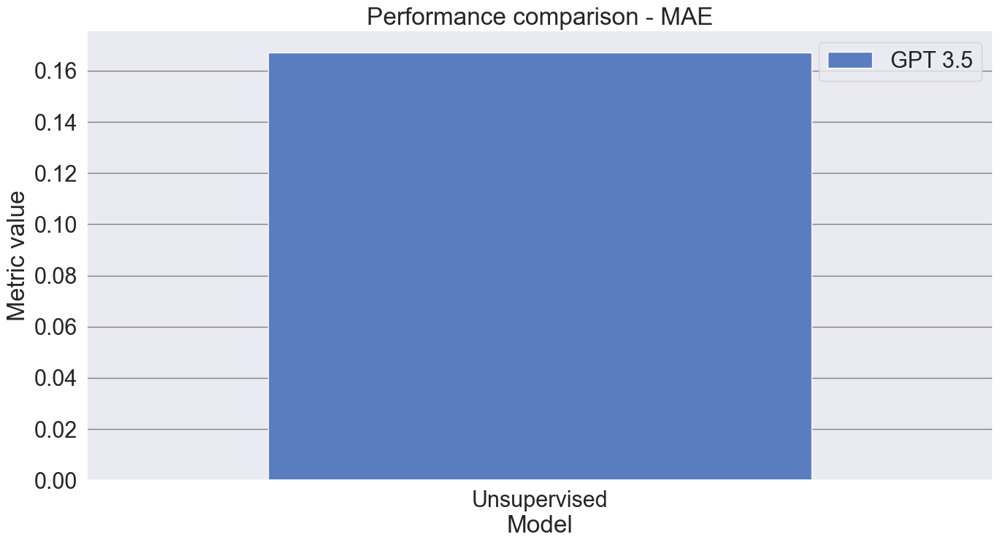

In [80]:
mae_df = pd.DataFrame(metrics_results['mae'], columns=['model', 'type', 'value'])
plot_results(mae_df, 'Performance comparison - MAE')

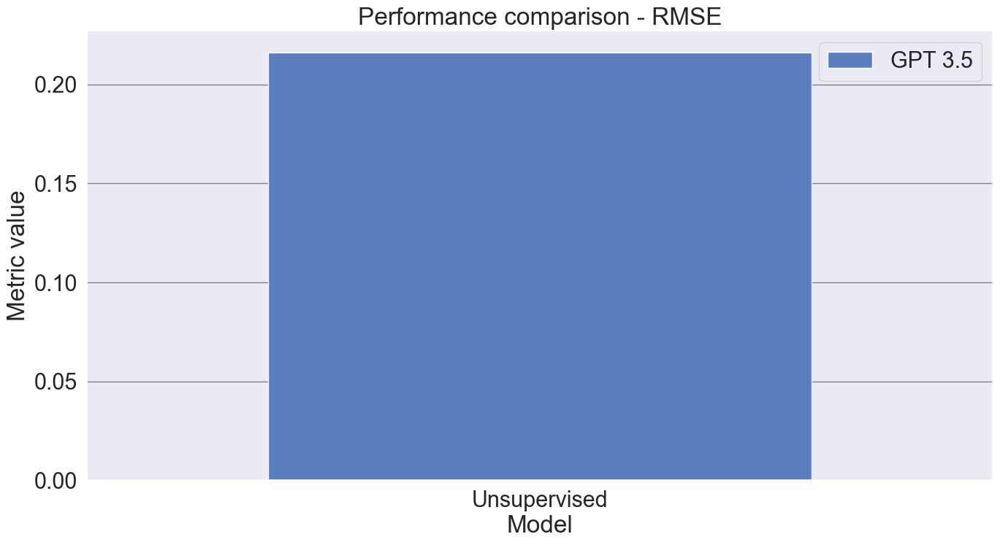

In [81]:
rmse_df = pd.DataFrame(metrics_results['rmse'], columns=['model', 'type', 'value'])
plot_results(rmse_df, 'Performance comparison - RMSE')

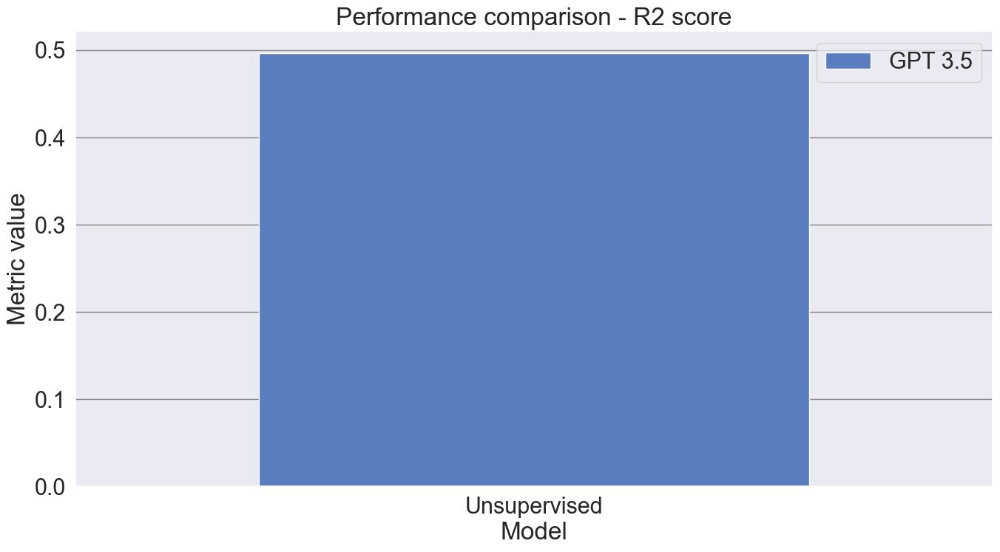

In [82]:
r2_df = pd.DataFrame(metrics_results['r2'], columns=['model', 'type', 'value'])
plot_results(r2_df, 'Performance comparison - R2 score')

## 3.2 Genre classification with BERT

## 3.3 Evaluation with another dataset